In [1]:
import numpy as np
import pandas as pd

# Multiclass Classification using SVM

Data Source:
https://www.kaggle.com/datasets/parulpandey/palmer-archipelago-antarctica-penguin-data?resource=download

In [2]:
data = pd.read_csv(r"C:\path")

In [3]:
data.head()

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex
0,Adelie,Torgersen,39.1,18.7,181.0,3750.0,MALE
1,Adelie,Torgersen,39.5,17.4,186.0,3800.0,FEMALE
2,Adelie,Torgersen,40.3,18.0,195.0,3250.0,FEMALE
3,Adelie,Torgersen,NaN,NaN,NaN,NaN,NaN
4,Adelie,Torgersen,36.7,19.3,193.0,3450.0,FEMALE


In [4]:
data.isnull().sum()

species               0
island                0
culmen_length_mm      2
culmen_depth_mm       2
flipper_length_mm     2
body_mass_g           2
sex                  10
dtype: int64

In [5]:
data.dropna(inplace = True)

In [6]:
data.isnull().sum()

species              0
island               0
culmen_length_mm     0
culmen_depth_mm      0
flipper_length_mm    0
body_mass_g          0
sex                  0
dtype: int64

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 334 entries, 0 to 343
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   species            334 non-null    object 
 1   island             334 non-null    object 
 2   culmen_length_mm   334 non-null    float64
 3   culmen_depth_mm    334 non-null    float64
 4   flipper_length_mm  334 non-null    float64
 5   body_mass_g        334 non-null    float64
 6   sex                334 non-null    object 
dtypes: float64(4), object(3)
memory usage: 20.9+ KB


In [8]:
data.describe()

,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g
count,334.000000,334.000000,334.000000,334.000000
mean,43.994311,17.160479,201.014970,4209.056886
std,5.460521,1.967909,14.022175,804.836129
min,32.100000,13.100000,172.000000,2700.000000
25%,39.500000,15.600000,190.000000,3550.000000
50%,44.500000,17.300000,197.000000,4050.000000
75%,48.575000,18.700000,213.000000,4793.750000
max,59.600000,21.500000,231.000000,6300.000000


C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


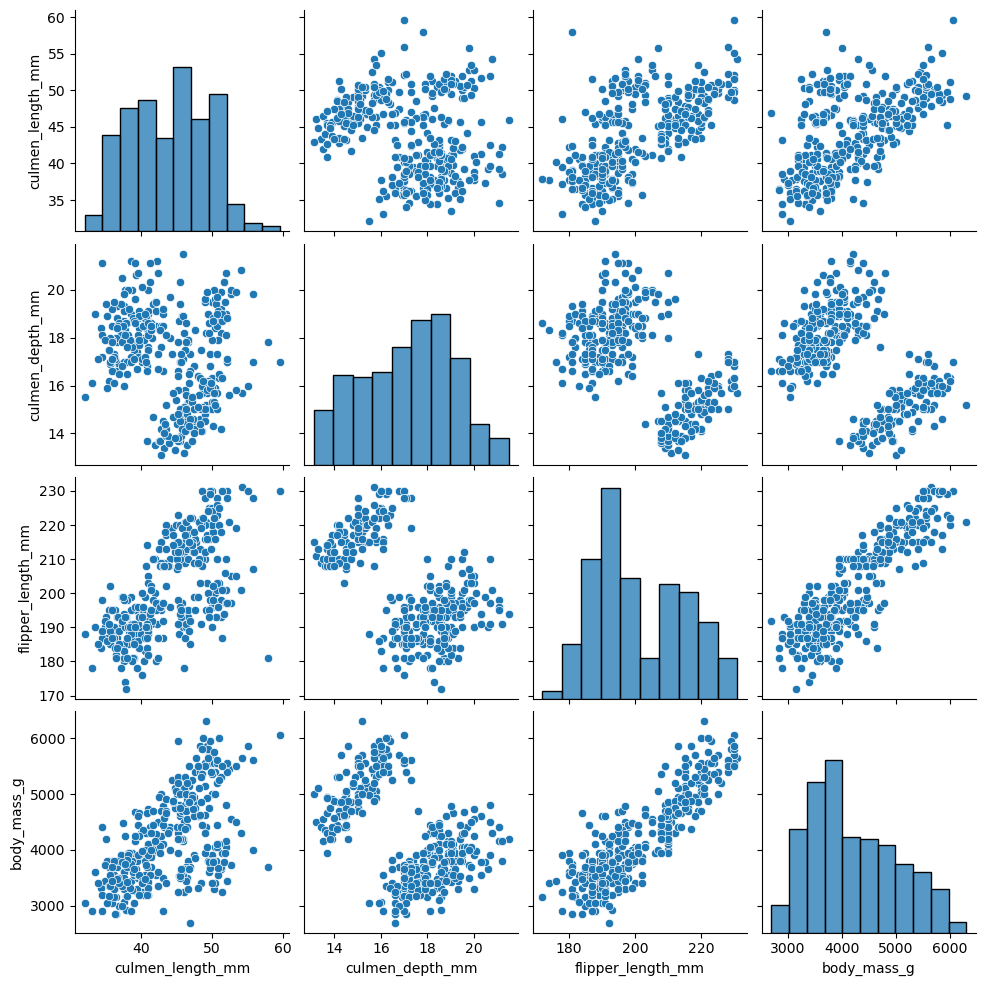

In [9]:
import seaborn as sns

sns.pairplot(data)

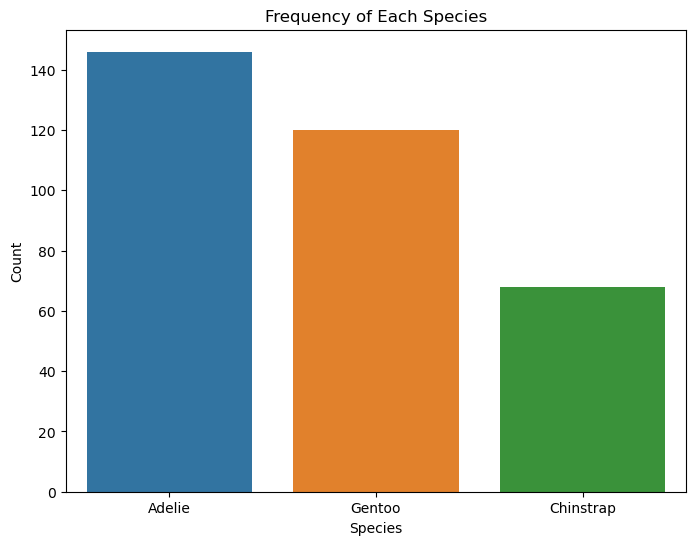

In [10]:
import matplotlib.pyplot as plt

freq_table = data['species'].value_counts().reset_index()
freq_table.columns = ['Species', 'Count']

plt.figure(figsize=(8, 6))
sns.barplot(x='Species', y='Count', data=freq_table)
plt.xlabel('Species')
plt.ylabel('Count')
plt.title('Frequency of Each Species')
plt.show()

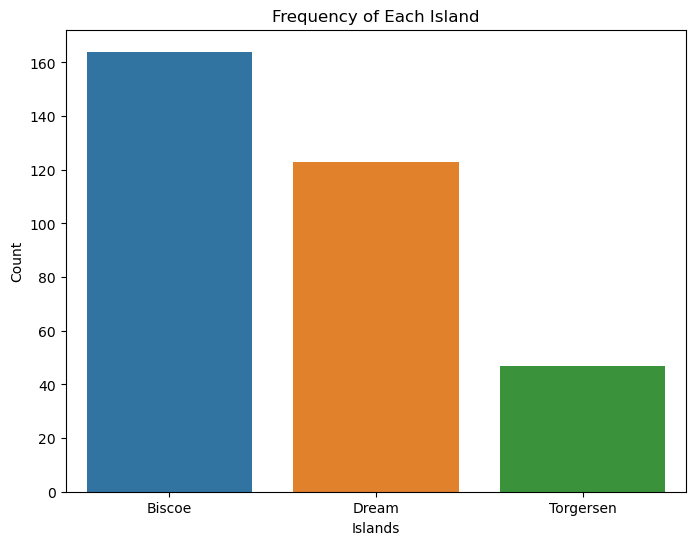

In [11]:
freq_table = data['island'].value_counts().reset_index()
freq_table.columns = ['island', 'Count']

plt.figure(figsize=(8, 6))
sns.barplot(x='island', y='Count', data=freq_table)
plt.xlabel('Islands')
plt.ylabel('Count')
plt.title('Frequency of Each Island')
plt.show()

['MALE' 'FEMALE']


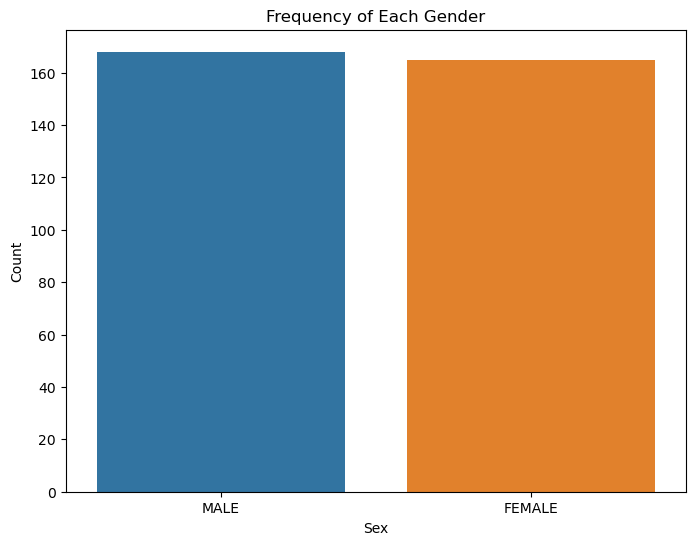

In [12]:
data = data.drop(data[data['sex'] == '.'].index)
freq_table = data['sex'].value_counts().reset_index()
freq_table.columns = ['sex', 'Count']
print(data['sex'].unique())
plt.figure(figsize=(8, 6))
sns.barplot(x='sex', y='Count', data=freq_table)
plt.xlabel('Sex')
plt.ylabel('Count')
plt.title('Frequency of Each Gender') 
plt.show()

In [13]:
data.dtypes

species               object
island                object
culmen_length_mm     float64
culmen_depth_mm      float64
flipper_length_mm    float64
body_mass_g          float64
sex                   object
dtype: object

In [14]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()

#data['species'] = le.fit_transform(data['species'])
data['island'] = le.fit_transform(data['island'])
data['sex'] = le.fit_transform(data['sex'])

In [15]:
data.head()

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex
0,Adelie,2,39.1,18.7,181.0,3750.0,1
1,Adelie,2,39.5,17.4,186.0,3800.0,0
2,Adelie,2,40.3,18.0,195.0,3250.0,0
4,Adelie,2,36.7,19.3,193.0,3450.0,0
5,Adelie,2,39.3,20.6,190.0,3650.0,1


In [16]:
data.tail()

,species,island,culmen_length_mm,culmen_depth_mm,flipper_length_mm,body_mass_g,sex
338,Gentoo,0,47.2,13.7,214.0,4925.0,0
340,Gentoo,0,46.8,14.3,215.0,4850.0,0
341,Gentoo,0,50.4,15.7,222.0,5750.0,1
342,Gentoo,0,45.2,14.8,212.0,5200.0,0
343,Gentoo,0,49.9,16.1,213.0,5400.0,1


In [17]:
data.columns

Index(['species', 'island', 'culmen_length_mm', 'culmen_depth_mm',
       'flipper_length_mm', 'body_mass_g', 'sex'],
      dtype='object')

In [18]:
x = data[['island', 'culmen_length_mm', 'culmen_depth_mm',
       'flipper_length_mm', 'body_mass_g', 'sex']]

y = data[['species']]


from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [19]:
print(x_train.shape)
print(y_train.shape)

(266, 6)
(266, 1)


In [20]:
y_train.head()

,species
230,Gentoo
84,Adelie
303,Gentoo
22,Adelie
29,Adelie


In [21]:
from sklearn import svm

model_l = svm.SVC(kernel = 'linear')

model_l.fit(x_train, y_train)

pred = model_l.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

Accuracy: 1.0


C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([[31,  0,  0],
       [ 0, 13,  0],
       [ 0,  0, 23]], dtype=int64)

In [22]:
from sklearn.metrics import classification_report
target_names = ['Adelie', 'Gentoo' , 'Chinstrap']
print(classification_report(y_test, pred, target_names=target_names))

              precision    recall  f1-score   support

      Adelie       1.00      1.00      1.00        31
      Gentoo       1.00      1.00      1.00        13
   Chinstrap       1.00      1.00      1.00        23

    accuracy                           1.00        67
   macro avg       1.00      1.00      1.00        67
weighted avg       1.00      1.00      1.00        67



In [23]:
# model_l.probability = True
# r_probs = [0 for _ in range(len(y_test))]
# rf_probs = model_l.predict_proba(x_test)
# rf_probs = rf_probs[:, 1]
# r_auc = roc_auc_score(y_test, r_probs)
# rf_auc = roc_auc_score(y_test, rf_probs)

# from sklearn.metrics import roc_curve, roc_auc_score
# print('SVM (chance) Prediction: AUROC = %.3f' % (r_auc))
# print('SVM: AUROC = %.3f' % (rf_auc))
# r_fpr, r_tpr, _ = roc_curve(y_test, r_probs)
# rf_fpr, rf_tpr, _ = roc_curve(y_test, rf_probs)
# plt.plot(r_fpr, r_tpr, linestyle='--', label='SVM prediction (AUROC = %0.3f)' % r_auc)
# plt.plot(rf_fpr, rf_tpr, marker='.', label='SVM (AUROC = %0.3f)' % rf_auc)
# # Title
# plt.title('ROC Plot')
# # Axis labels
# plt.xlabel('False Positive Rate')
# plt.ylabel('True Positive Rate')
# # Show legend
# plt.legend() # 
# # Show plot
# plt.show()

In [24]:
from sklearn import svm

model = svm.SVC(kernel = 'rbf')

model.fit(x_train, y_train)

pred = model.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

Accuracy: 0.7313432835820896


C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([[29,  0,  2],
       [13,  0,  0],
       [ 3,  0, 20]], dtype=int64)

In [25]:
from sklearn import svm

model = svm.SVC(kernel = 'poly')

model.fit(x_train, y_train)

pred = model.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

Accuracy: 0.7313432835820896


C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([[29,  0,  2],
       [13,  0,  0],
       [ 3,  0, 20]], dtype=int64)

In [26]:
from sklearn import svm

model = svm.SVC(kernel = 'sigmoid')

model.fit(x_train, y_train)

pred = model.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

Accuracy: 0.16417910447761194


C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([[11,  0, 20],
       [ 6,  0,  7],
       [23,  0,  0]], dtype=int64)

In [27]:
from sklearn import svm

model = svm.SVC(kernel = 'rbf', gamma = 'auto')

model.fit(x_train, y_train)

pred = model.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

Accuracy: 0.6567164179104478


C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([[31,  0,  0],
       [12,  1,  0],
       [11,  0, 12]], dtype=int64)

In [28]:
from sklearn import svm

model = svm.SVC(kernel = 'rbf', gamma = 'scale')

model.fit(x_train, y_train)

pred = model.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

Accuracy: 0.7313432835820896


C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([[29,  0,  2],
       [13,  0,  0],
       [ 3,  0, 20]], dtype=int64)

In [29]:
from sklearn import svm

model = svm.SVC(kernel = 'rbf', gamma = 0.01)

model.fit(x_train, y_train)

pred = model.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Accuracy: 0.8507462686567164


array([[29,  1,  1],
       [ 6,  7,  0],
       [ 1,  1, 21]], dtype=int64)

In [30]:
from sklearn import svm

model = svm.SVC(kernel = 'rbf', gamma = 0.05)

model.fit(x_train, y_train)

pred = model.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Accuracy: 0.7910447761194029


array([[31,  0,  0],
       [10,  3,  0],
       [ 4,  0, 19]], dtype=int64)

In [31]:
from sklearn import svm

model = svm.SVC(kernel = 'rbf', gamma = 0.001)

model.fit(x_train, y_train)

pred = model.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

Accuracy: 0.7761194029850746


C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([[24,  2,  5],
       [ 7,  6,  0],
       [ 0,  1, 22]], dtype=int64)

In [32]:
#https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html

In [33]:
# y_pred_proba = model_l.predict_proba(X_test)[::,1]
# fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
# auc = metrics.roc_auc_score(y_test, y_pred_proba)
# plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
# plt.legend(loc=4)
# plt.show()

# Binary Classification

In [34]:
df = pd.read_csv(r"D:\Varshini\VIT\Sem 6\ml\Lab\Lab7\creditcard.csv")
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [35]:
df['Class'].unique()

array([0, 1], dtype=int64)

In [36]:
freq_table = df['Class'].value_counts().reset_index()
freq_table.columns = ['Class', 'Count']
print(freq_table)

   Class   Count
0      0  284315
1      1     492


In [37]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [38]:
df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,...,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [39]:
import seaborn as sns
sns.pairplot(df)

C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


In [40]:
# Count the number of rows with 'Class' value as 0
num_class_0 = (df['Class'] == 0).sum()

# Randomly select 1000 rows with 'Class' value as 0 to delete
rows_to_delete = df[df['Class'] == 0].sample(n=200000).index

# Delete the selected rows
df.drop(rows_to_delete, inplace=True)

# Checking if 1000 rows are deleted
new_num_class_0 = (df['Class'] == 0).sum()
print("Number of rows with 'Class' value 0 after deletion:", new_num_class_0)

# Optionally, you can reset the index after deletion
df.reset_index(drop=True, inplace=True)


Number of rows with 'Class' value 0 after deletion: 84315


In [41]:
x = df.drop(['Class'], axis=1)

y = df[['Class']]


from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [42]:
from sklearn import svm

model_l = svm.SVC(kernel = 'linear')

model_l.fit(x_train, y_train)

pred = model_l.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, pred)

C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Accuracy: 0.9961089494163424


array([[16864,     8],
       [   58,    32]], dtype=int64)

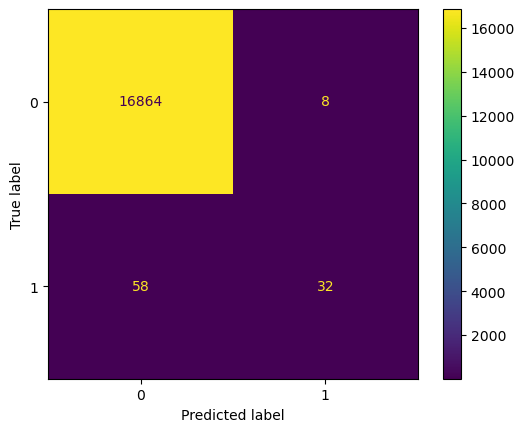

In [43]:
from sklearn.metrics import ConfusionMatrixDisplay
import matplotlib.pyplot as plt

cm = confusion_matrix(y_test, pred, labels=model_l.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=model_l.classes_)

disp.plot()
plt.show()

In [44]:
from sklearn.metrics import classification_report
target_names = ['Adelie' , 'Chinstrap']
print(classification_report(y_test, pred, target_names=target_names))

              precision    recall  f1-score   support

      Adelie       1.00      1.00      1.00     16872
   Chinstrap       0.80      0.36      0.49        90

    accuracy                           1.00     16962
   macro avg       0.90      0.68      0.75     16962
weighted avg       1.00      1.00      1.00     16962



In [45]:
from sklearn import svm

model_l = svm.SVC(kernel = 'rbf')

model_l.fit(x_train, y_train)

pred = model_l.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

# from sklearn.metrics import confusion_matrix

# confusion_matrix(y_test, pred)

# from sklearn.metrics import ConfusionMatrixDisplay
# import matplotlib.pyplot as plt

# cm = confusion_matrix(y_test, pred, labels=model_l.classes_)
# disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=model_l.classes_)

# disp.plot()
# plt.show()

C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Accuracy: 0.994694021931376


In [46]:
from sklearn import svm

model_l = svm.SVC(kernel = 'sigmoid')

model_l.fit(x_train, y_train)

pred = model_l.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

# from sklearn.metrics import confusion_matrix

# confusion_matrix(y_test, pred)

# from sklearn.metrics import ConfusionMatrixDisplay
# import matplotlib.pyplot as plt

# cm = confusion_matrix(y_test, pred, labels=model_l.classes_)
# disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=model_l.classes_)

# disp.plot()
# plt.show()

C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Accuracy: 0.994694021931376


In [47]:
from sklearn import svm

model_l = svm.SVC(kernel = 'poly')

model_l.fit(x_train, y_train)

pred = model_l.predict(x_test)

from sklearn.metrics import accuracy_score

print("Accuracy:",accuracy_score(y_test,pred))

# from sklearn.metrics import confusion_matrix

# confusion_matrix(y_test, pred)

# from sklearn.metrics import ConfusionMatrixDisplay
# import matplotlib.pyplot as plt

# cm = confusion_matrix(y_test, pred, labels=model_l.classes_)
# disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=model_l.classes_)

# disp.plot()
# plt.show()

C:\Users\varsh\anaconda3\anaconda_3\Lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Accuracy: 0.994694021931376
